# USD - MSADS 500B Final Project 2nd Version 

# Part 1: Data preparation:

In [1]:
#### Import the needed pacakges
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pylab
from pylab import xticks
import seaborn as sns
import statsmodels.api as sm
import warnings
import plotly.express as px
import geopandas as gpd
from shapely.geometry import Point, Polygon

from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler,PolynomialFeatures
from sklearn.linear_model import LinearRegression
%matplotlib inline

In [2]:
#### Read and get to know about the file
house_raw = pd.read_csv("/Users/UE/Desktop/house_sales.csv")
house_raw.info()
house_raw

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       20479 non-null  float64
 4   bathrooms      20545 non-null  float64
 5   sqft_living    20503 non-null  float64
 6   sqft_lot       20569 non-null  float64
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3.0,1.00,1180.0,5650.0,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3.0,2.25,2570.0,7242.0,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2.0,1.00,770.0,10000.0,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4.0,3.00,1960.0,5000.0,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3.0,2.00,1680.0,8080.0,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,20140521T000000,360000.0,3.0,2.50,1530.0,1131.0,3.0,0,0,...,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,20150223T000000,400000.0,4.0,2.50,2310.0,5813.0,2.0,0,0,...,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,20140623T000000,402101.0,2.0,0.75,1020.0,1350.0,2.0,0,0,...,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,20150116T000000,400000.0,3.0,2.50,1600.0,2388.0,2.0,0,0,...,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


In [3]:
#### Count the missing values
house_raw.isnull().sum()

id                  0
date                0
price               0
bedrooms         1134
bathrooms        1068
sqft_living      1110
sqft_lot         1044
floors              0
waterfront          0
view                0
condition           0
grade               0
sqft_above          0
sqft_basement       0
yr_built            0
yr_renovated        0
zipcode             0
lat                 0
long                0
sqft_living15       0
sqft_lot15          0
dtype: int64

In [4]:
import warnings
warnings.filterwarnings('ignore')
warnings.warn('DelftStack')
warnings.warn('Do not show this message')
print("No Warning Shown")

No Warning Shown


#### From the above info we can know, there are 4 varaibles that contain missing values.
#### First, Let's see how the 4 variables distribution.

<AxesSubplot:xlabel='sqft_lot'>

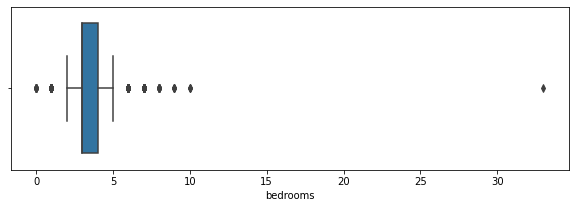

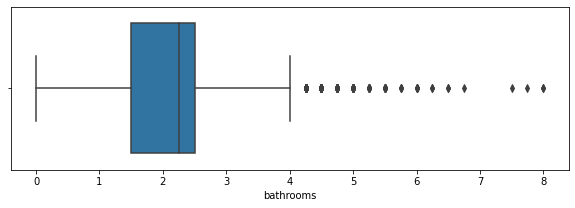

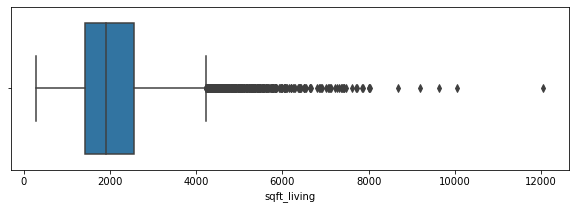

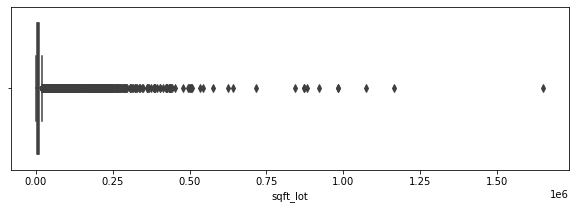

In [5]:
fig,ax = plt.subplots(figsize = (10,3))
sns.boxplot(house_raw.bedrooms)

fig,ax = plt.subplots(figsize = (10,3))
sns.boxplot(house_raw.bathrooms)

fig,ax = plt.subplots(figsize = (10,3))
sns.boxplot(house_raw.sqft_living)

fig,ax = plt.subplots(figsize = (10,3))
sns.boxplot(house_raw.sqft_lot)

#### All 4 variables are right skwed. Outliers data points will have a significant impact on the mean. 
#### Thus, we will use median to fill the missing values.

In [6]:
house_raw['bedrooms'] = house_raw['bedrooms'].fillna(house_raw['bedrooms'].median())
house_raw['bathrooms'] = house_raw['bathrooms'].fillna(house_raw['bathrooms'].median())
house_raw['sqft_living'] = house_raw['sqft_living'].fillna(house_raw['sqft_living'].median())
house_raw['sqft_lot'] = house_raw['sqft_lot'].fillna(house_raw['sqft_lot'].median())

In [7]:
# confirm all the missing values has been replaced
house_raw.isnull().sum()

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

In [8]:
# Replace the bedroom outlier:
house_raw['bedrooms'].value_counts().to_frame()

,bedrooms
3.0,10420
4.0,6519
2.0,2617
5.0,1539
6.0,263
1.0,189
7.0,34
8.0,12
0.0,11
9.0,5


In [9]:
house_raw['bedrooms'] = house_raw['bedrooms'].replace(33.0, 3.0, regex=True)
house_raw['bedrooms'].value_counts().to_frame()

,bedrooms
3.0,10421
4.0,6519
2.0,2617
5.0,1539
6.0,263
1.0,189
7.0,34
8.0,12
0.0,11
9.0,5


#### View = 1 means the house has a view, view = 0 means the house doesn't have a view. 
#### Based on the viariable description, view = 2,3,4 are wrong data entry.
#### We will use 1 to replace the wrong data entry.

In [10]:
house_raw['view'].value_counts().to_frame()

,view
0,19489
2,963
3,510
1,332
4,319


In [11]:
house_raw['view'] = house_raw['view'].replace(2.0, 1.0, regex=True)
house_raw['view'] = house_raw['view'].replace(3.0, 1.0, regex=True)
house_raw['view'] = house_raw['view'].replace(4.0, 1.0, regex=True)
house_raw['view'].value_counts().to_frame()

,view
0,19489
1,2124


In [12]:
house_raw.corr()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.000000,-0.016762,0.005919,0.002101,-0.011529,-0.130281,0.018525,-0.002721,0.011405,-0.023783,0.008130,-0.010842,-0.005151,0.021380,-0.016907,-0.008224,-0.001891,0.020799,-0.002901,-0.138798
price,-0.016762,1.000000,0.309783,0.515365,0.681527,0.086530,0.256794,0.266369,0.359120,0.036362,0.667434,0.605567,0.323816,0.054012,0.126434,-0.053203,0.307003,0.021626,0.585379,0.082447
bedrooms,0.005919,0.309783,1.000000,0.500483,0.563855,0.028207,0.177992,-0.005037,0.082806,0.025030,0.358322,0.479064,0.298110,0.155478,0.020089,-0.154092,-0.010543,0.131066,0.392331,0.025166
bathrooms,0.002101,0.515365,0.500483,1.000000,0.714307,0.083146,0.487859,0.067113,0.170830,-0.123002,0.648745,0.667757,0.276989,0.495315,0.048536,-0.200677,0.026612,0.218557,0.554516,0.086509
sqft_living,-0.011529,0.681527,0.563855,0.714307,1.000000,0.159695,0.345290,0.105203,0.264924,-0.057751,0.744259,0.850785,0.420720,0.310977,0.055857,-0.193794,0.049893,0.232981,0.736945,0.175089
sqft_lot,-0.130281,0.086530,0.028207,0.083146,0.159695,1.000000,-0.005718,0.020783,0.067403,-0.008757,0.109016,0.176831,0.015346,0.050494,0.008588,-0.127739,-0.085286,0.223731,0.142063,0.717635
floors,0.018525,0.256794,0.177992,0.487859,0.345290,-0.005718,1.000000,0.023698,0.017871,-0.263768,0.458183,0.523885,-0.245705,0.489319,0.006338,-0.059121,0.049614,0.125419,0.279885,-0.011269
waterfront,-0.002721,0.266369,-0.005037,0.067113,0.105203,0.020783,0.023698,1.000000,0.264057,0.016653,0.082775,0.072075,0.080588,-0.026161,0.092885,0.030285,-0.014274,-0.041910,0.086463,0.030703
view,0.011405,0.359120,0.082806,0.170830,0.264924,0.067403,0.017871,0.264057,1.000000,0.047143,0.237327,0.153325,0.275310,-0.062810,0.095029,0.091213,0.009529,-0.088244,0.273444,0.064345
condition,-0.023783,0.036362,0.025030,-0.123002,-0.057751,-0.008757,-0.263768,0.016653,0.047143,1.000000,-0.144674,-0.158214,0.174105,-0.361417,-0.060618,0.003026,-0.014941,-0.106500,-0.092824,-0.003406


# Part 2: Data Visualization:

### 2.1 Bedroom numbers of the house:

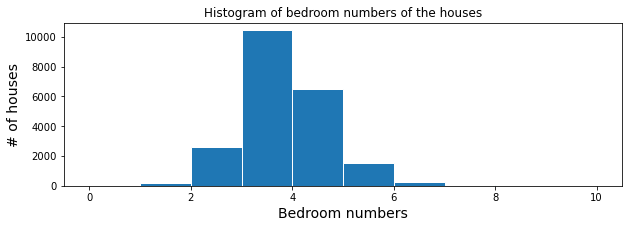

In [13]:
#### Using histogram to identify how many bedrooms is the most popular home type
bedroom = house_raw['bedrooms']
plt.figure(figsize=(10,3))
plt.hist(bedroom, bins=10, edgecolor='white')
plt.xlabel('Bedroom numbers', fontsize=14)
plt.ylabel('# of houses', fontsize=14)
plt.title('Histogram of bedroom numbers of the houses')
plt.show()

In [14]:
bedroom.describe()

count    21613.000000
mean         3.351872
std          0.887140
min          0.000000
25%          3.000000
50%          3.000000
75%          4.000000
max         10.000000
Name: bedrooms, dtype: float64

#### Thus we know, a houses with 3 rooms is the most popular home type
#### Next let's see the bedroom numbers and their prices

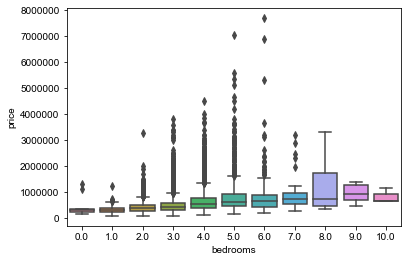

In [15]:
bedroom_box = sns.boxplot(x="bedrooms", y="price", data=house_raw)
plt.ticklabel_format(style='plain', axis='y')
sns.set(rc={'figure.figsize':(20,10)})

In [56]:
fig_bedrm = px.scatter(house_raw, x="bedrooms", y="price", trendline="ols")
fig_bedrm.show()

### 2.2 Bathroom numbers

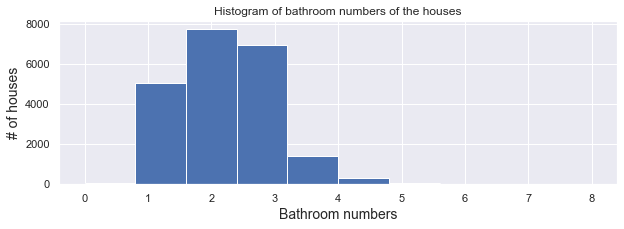

In [17]:
#### Using histogram to identify how many bedrooms is the most popular home type
bathroom = house_raw['bathrooms']
plt.figure(figsize=(10,3))
plt.hist(bathroom, bins=10, edgecolor='white')
plt.xlabel('Bathroom numbers', fontsize=14)
plt.ylabel('# of houses', fontsize=14)
plt.title('Histogram of bathroom numbers of the houses')
plt.show()

In [18]:
print(bathroom.describe())
print(bathroom.mode())

count    21613.000000
mean         2.120252
std          0.750257
min          0.000000
25%          1.750000
50%          2.250000
75%          2.500000
max          8.000000
Name: bathrooms, dtype: float64
0    2.5
Name: bathrooms, dtype: float64


In [57]:
fig_barm = px.scatter(house_raw, x="bathrooms", y="price", trendline="ols")
fig_barm.show()

#### The average bathroom of a house is 2.12. Most ccommon bathroom number is 2.5

### 2.3 Living squarefeet of the house:

In [20]:
house_raw['sqft_living'].value_counts().to_frame()

,sqft_living
1920.0,1200
1300.0,132
1400.0,130
1440.0,129
1660.0,125
...,...
1092.0,1
6300.0,1
3847.0,1
1788.0,1


In [58]:
fig_sqft = px.scatter(house_raw, x="sqft_living", y="price", trendline="ols")
fig_sqft.show()

#### From the above graph we can know the living sqft is positive coorelated with the house price.

### 2.4 sqft_lot of the house:

In [59]:
fig_lot = px.scatter(house_raw, x="sqft_lot", y="price", trendline="ols")
fig_lot.show()

### 2.5 Floor number and the house  price:

In [60]:
fig_floor = px.scatter(house_raw, x="floors", y="price", trendline="ols")
fig_floor.show()

#### Thus we can tell, the floor numbers has a  week positive correlation with the house price. 
#### The most popular floor number is 2.

### 2.6 Water front:

#### 1 means the house has a water front. 0 means the house doesn't have a water front.

In [24]:
house_raw['waterfront'].value_counts().to_frame()

,waterfront
0,21450
1,163


In [25]:
#### Let's first create two new tables that one is with waterfront, but one is not
with_waterfront = house_raw[house_raw['waterfront'] == 1]
no_waterfront = house_raw[house_raw['waterfront'] == 0]
with_waterfront_price_mean = with_waterfront['price'].mean()
print("Houses with waterfront average price is ", with_waterfront_price_mean,"$")
no_waterfront_price_mean = no_waterfront['price'].mean()
print("Houses that has no basement average price is", no_waterfront_price_mean,"$")

Houses with waterfront average price is  1661876.0245398772 $
Houses that has no basement average price is 531563.5998135199 $


In [26]:
# Crate a dataframe:
data_waterfront = [with_waterfront_price_mean, 'With Waterfront'], [no_waterfront_price_mean, 'No Waterfront']
# Create the pandas DataFrame
waterfront = pd.DataFrame(data_waterfront, columns=['Avg_Price', 'Waterfront'])
# print dataframe.
waterfront

,Avg_Price,Waterfront
0,1.661876e+06,With Waterfront
1,5.315636e+05,No Waterfront


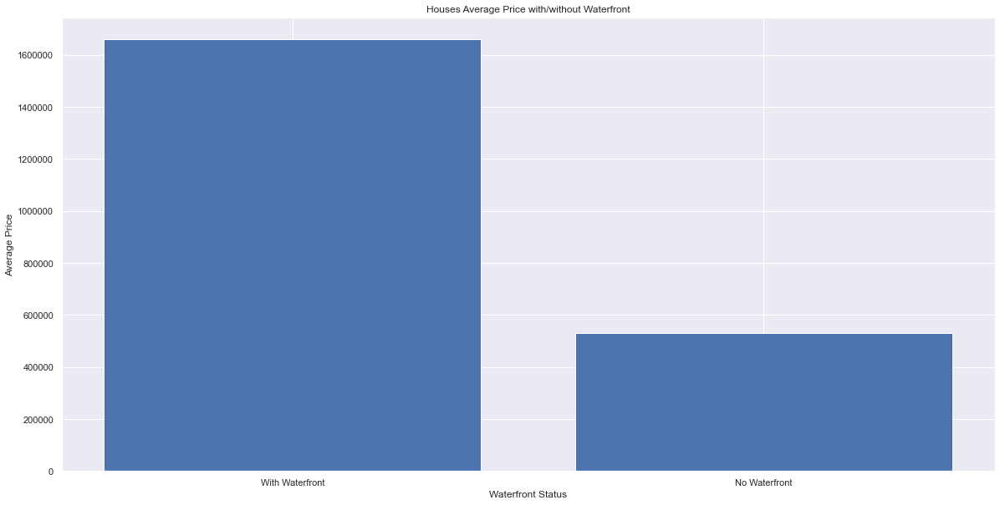

In [27]:
plt.xlabel("Waterfront Status")
plt.ylabel("Average Price")
plt.bar(waterfront['Waterfront'], waterfront['Avg_Price'])
plt.gcf().axes[0].yaxis.get_major_formatter().set_scientific(False)
plt.title("Houses Average Price with/without Waterfront")
plt.show()

### 2.7 View:

#### Based on the description, view is 0 means the house has no view, view is 1 means the house has view.

In [28]:
with_view = house_raw[house_raw['view'] == 1]
no_view = house_raw[house_raw['view'] == 0]
with_view_price_mean = with_view['price'].mean()
print("Houses with view average price is ", with_view_price_mean,"$")
no_view_price_mean = no_view['price'].mean()
print("Houses that has no view average price is", no_view_price_mean,"$")

Houses with view average price is  939447.0188323917 $
Houses that has no view average price is 496564.19210836885 $


In [29]:
# Crate a dataframe:
data_view = [with_view_price_mean, 'With View'], [no_view_price_mean, 'No View']
# Create the pandas DataFrame
view = pd.DataFrame(data_view, columns=['Avg_Price', 'View'])
# print dataframe.
view

,Avg_Price,View
0,939447.018832,With View
1,496564.192108,No View


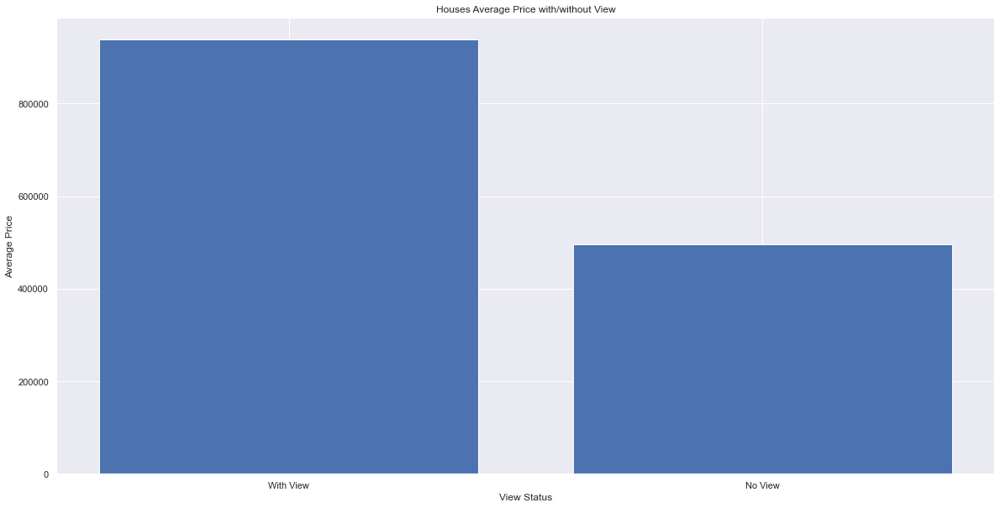

In [30]:
plt.xlabel("View Status")
plt.ylabel("Average Price")
plt.bar(view['View'], view['Avg_Price'])
plt.gcf().axes[0].yaxis.get_major_formatter().set_scientific(False)
plt.title("Houses Average Price with/without View")
plt.show()

### 2.8 Condition of the house

In [31]:
house_raw['condition'].value_counts().to_frame()

,condition
3,14031
4,5679
5,1701
2,172
1,30


In [61]:
fig_condition = px.scatter(house_raw, x="condition", y="price", trendline="ols")
fig_condition.show()

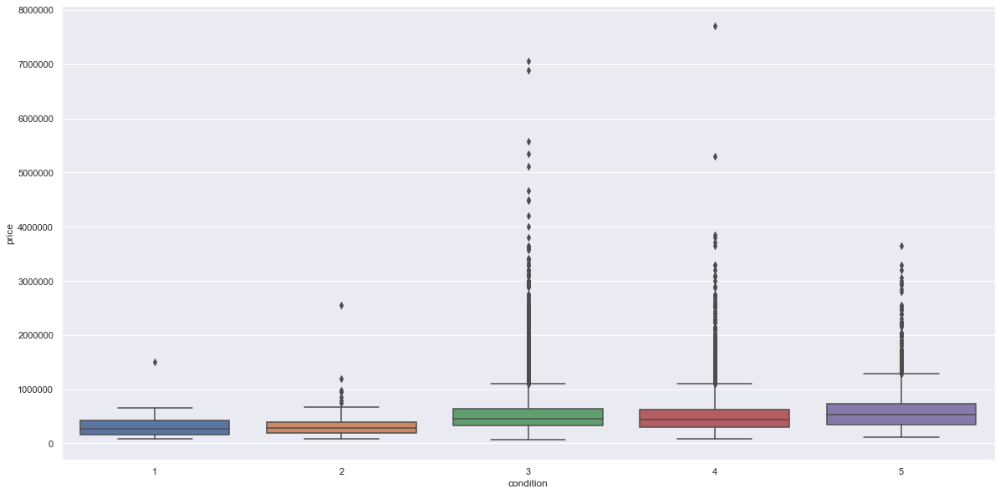

In [33]:
condition_box = sns.boxplot(x="condition", y="price", data=house_raw)
plt.ticklabel_format(style='plain', axis='y')
sns.set(rc={'figure.figsize':(20,10)})

#### Thus, cannot tell the condition is really affect the house price.

### 2.9 Grade of the house

In [34]:
house_raw['grade'].value_counts().to_frame()

,grade
7,8981
8,6068
9,2615
6,2038
10,1134
11,399
5,242
12,90
4,29
13,13


In [62]:
fig_grade = px.scatter(house_raw, x="grade", y="price", trendline="ols")
fig_grade.show()

### 2.10 Year built of the house

In [36]:
house_raw['yr_built'].value_counts().to_frame()

,yr_built
2014,559
2006,454
2005,450
2004,433
2003,422
...,...
1933,30
1901,29
1902,27
1935,24


In [63]:
fig_year = px.scatter(house_raw, x="yr_built", y="price", trendline="ols")
fig_year.show()

Text(0.5, 1.0, 'Median Price by Year Built')

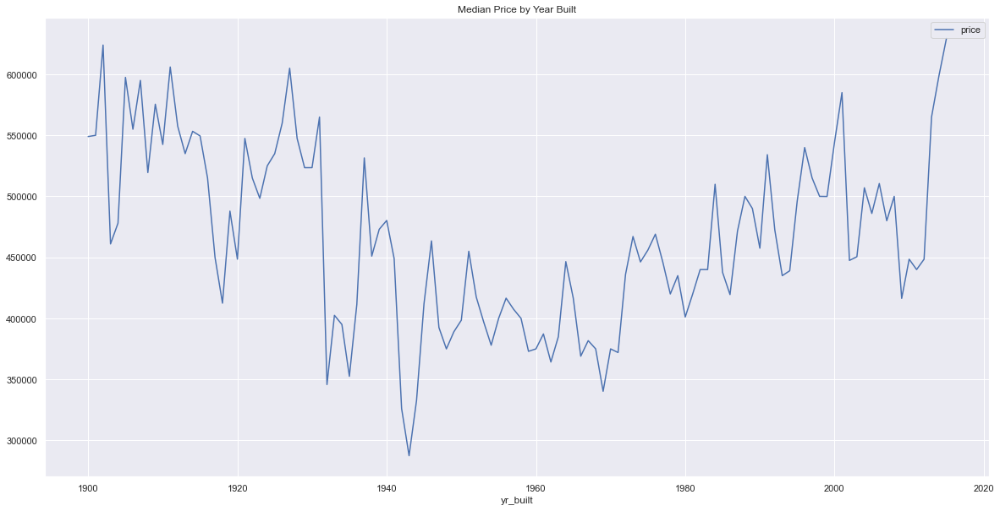

In [38]:
# Get the median price by the year and plot them:
price_year = house_raw[['yr_built','price'] ]
price_year
price_year.groupby(['yr_built'])['price'].median().plot(legend = True)
plt.title("Median Price by Year Built")

#### from the above 2 images, we can tell the year built and the house price does not positive correlated

### 2.11 Renvation Status of the house

In [39]:
#### Let's first create two new tables that one is renovated before, but one is not
new_reno = house_raw[house_raw['yr_renovated'] != 0]
no_reno = house_raw[house_raw['yr_renovated'] == 0]
new_reno_price_mean = new_reno['price'].median()
print("Renovated houses average price is ", new_reno_price_mean,"$")
no_reno_price_mean = no_reno['price'].median()
print("Houses that not renvated average price is", no_reno_price_mean,"$")

Renovated houses average price is  600000.0 $
Houses that not renvated average price is 448000.0 $


In [40]:
# Crate a dataframe:
data_reno = [new_reno_price_mean, 'With Renovation'], [no_reno_price_mean, 'No Removation']
# Create the pandas DataFrame
reno = pd.DataFrame(data_reno, columns=['Avg_Price', 'Status'])
# print dataframe.
reno

,Avg_Price,Status
0,600000.0,With Renovation
1,448000.0,No Removation


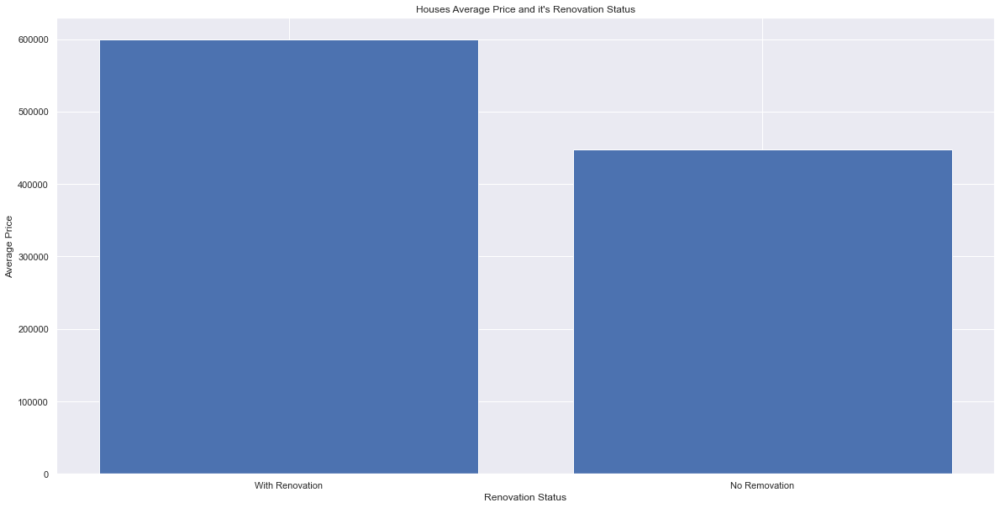

In [41]:
# Generate a bar plot to better shows the price difference:
plt.xlabel("Renovation Status")
plt.ylabel("Average Price")
plt.bar(reno['Status'], reno['Avg_Price'])
plt.gcf().axes[0].yaxis.get_major_formatter().set_scientific(False)
plt.title("Houses Average Price and it's Renovation Status")
plt.show()

### 2.12 Zip code and it's price:

In [42]:
house_raw['zipcode'].value_counts().to_frame()

,zipcode
98103,602
98038,590
98115,583
98052,574
98117,553
...,...
98102,105
98010,100
98024,81
98148,57


In [43]:
zip_price_mean = house_raw['zipcode'].median()
print("Renovated houses average price is ", new_reno_price_mean,"$")
no_reno_price_mean = no_reno['price'].median()
print("Houses that not renvated average price is", no_reno_price_mean,"$")

Renovated houses average price is  600000.0 $
Houses that not renvated average price is 448000.0 $


In [44]:
zip_data = house_raw[['zipcode', 'price']]
zip_data

,zipcode,price
0,98178,221900.0
1,98125,538000.0
2,98028,180000.0
3,98136,604000.0
4,98074,510000.0
...,...,...
21608,98103,360000.0
21609,98146,400000.0
21610,98144,402101.0
21611,98027,400000.0


In [45]:
zip_price = zip_data.groupby(['zipcode']).median()
zip_price

,price
zipcode,
98001,260000.0
98002,235000.0
98003,267475.0
98004,1150000.0
98005,765475.0
...,...
98177,554000.0
98178,278277.0
98188,264000.0


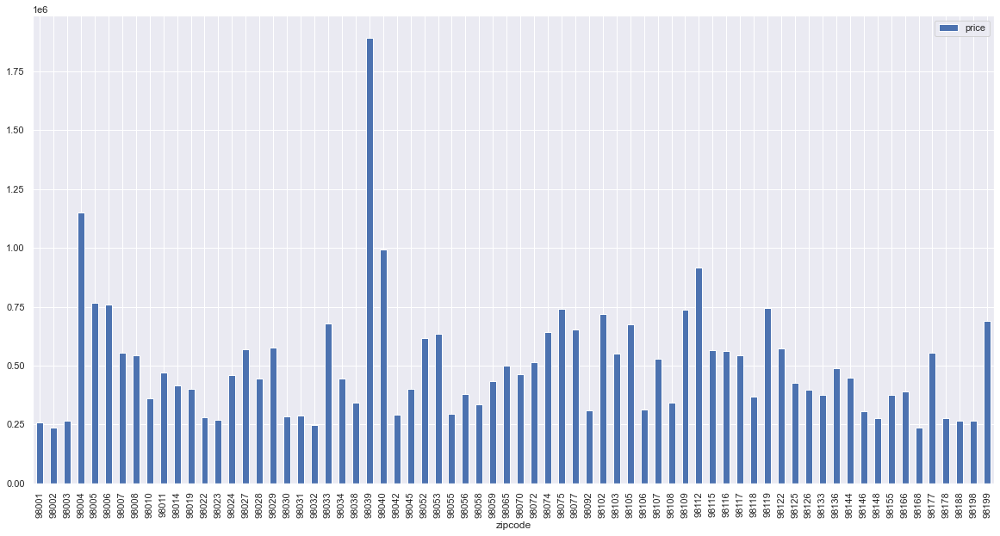

In [46]:
zip_price.groupby('zipcode')['price'].median().plot(kind = 'bar', legend=True )
plt.show()

### 2.13 House price and it's Geo location

In [47]:
map = house_raw[['price','lat', 'long'] ]
map.describe()

,price,lat,long
count,2.161300e+04,21613.000000,21613.000000
mean,5.400881e+05,47.560053,-122.213896
std,3.671272e+05,0.138564,0.140828
min,7.500000e+04,47.155900,-122.519000
25%,3.219500e+05,47.471000,-122.328000
50%,4.500000e+05,47.571800,-122.230000
75%,6.450000e+05,47.678000,-122.125000
max,7.700000e+06,47.777600,-121.315000


In [48]:
# Remove the most extreme 1% prices,
# the most extreme .1% latitudes, &
# the most extreme .1% longitudes
map2 = map[(map['price'] >= np.percentile(map['price'], 0.5)) & 
 (map['price'] <= np.percentile(map['price'], 99.5)) & 
 (map['lat'] >= np.percentile(map['lat'], 0.05)) & 
 (map['lat'] < np.percentile(map['lat'], 99.95)) &
 (map['long'] >= np.percentile(map['long'], 0.05)) & 
 (map['long'] <= np.percentile(map['long'], 99.95))]
map2.describe()

,price,lat,long
count,2.135100e+04,21351.000000,21351.000000
mean,5.290363e+05,47.560417,-122.213852
std,3.074869e+05,0.138371,0.139595
min,1.340000e+05,47.184000,-122.505000
25%,3.248940e+05,47.471300,-122.328000
50%,4.500000e+05,47.571900,-122.229000
75%,6.400000e+05,47.678300,-122.124000
max,2.450000e+06,47.777000,-121.402000


In [49]:
# import street map
street_map = gpd.read_file('/Users/UE/Desktop/WA/tl_2016_53_cousub.shp')
# Generate geometry to contain the longtitude and latitude
gdf = gpd.GeoDataFrame(
    map2, geometry=gpd.points_from_xy(map2['long'], map2['lat']))
print(gdf.head())

      price      lat     long                     geometry
0  221900.0  47.5112 -122.257  POINT (-122.25700 47.51120)
1  538000.0  47.7210 -122.319  POINT (-122.31900 47.72100)
2  180000.0  47.7379 -122.233  POINT (-122.23300 47.73790)
3  604000.0  47.5208 -122.393  POINT (-122.39300 47.52080)
4  510000.0  47.6168 -122.045  POINT (-122.04500 47.61680)


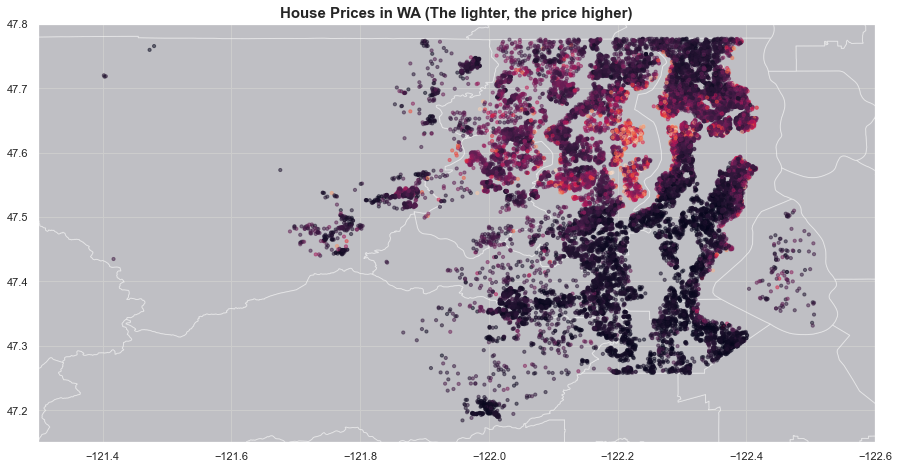

In [50]:
# create figure and axes, assign to subplot
fig, ax = plt.subplots(figsize=(15,10))
# add .shp mapfile to axe
street_map.plot(ax=ax, alpha=0.4,color='grey')
# add geodataframe to axes
# assign ‘price’ variable to represent coordinates on graph
# add legend
# make datapoints transparent using alpha
# assign size of points using markersize
gdf.plot(column='price',ax=ax,alpha=0.5, legend=False,markersize=10)

# add title to graph
plt.title('House Prices in WA (The lighter, the price higher)', fontsize=15,fontweight='bold')
# set latitiude and longitude boundaries for map display
plt.xlim(-121.30,-122.60)
plt.ylim( 47.15,47.80)
# show map
plt.show()

### 2.14 sqft_above, sqft_basement and the house price:

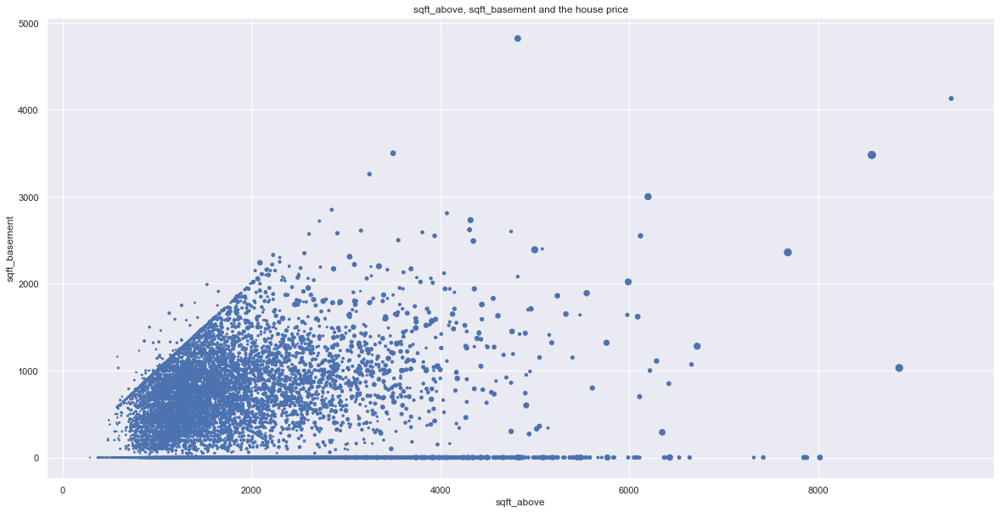

In [51]:
x = house_raw['sqft_above']
y = house_raw['sqft_basement']
size= house_raw['price']/100000
plt.xlabel("sqft_above")
plt.ylabel("sqft_basement")
plt.title("sqft_above, sqft_basement and the house price")
plt.scatter(x, y, s = size)

In [64]:
fig_sqabove = px.scatter(house_raw, x="sqft_above", y="price", trendline="ols")
fig_sqabove.show()

In [65]:
fig_sqbasement= px.scatter(house_raw, x="sqft_basement", y="price", trendline="ols")
fig_sqbasement.show()

# Part 3, Regression analysis

### Based on the above visualization for every single variables. We can get the conclusion that:
### The  "bedrooms", "bathrooms","sqft_living", "sqft_lot", "waterfront","view","grade", "sqft_above", "sqft_basement" all have a positive relationship with the house price.
### Thus, Let's create a regression to predict the house price.

In [68]:
Var_List = [ "bedrooms", "bathrooms","sqft_living", "sqft_lot",
            "waterfront","view","grade", "sqft_above", "sqft_basement"]

In [73]:
Reg_Y = house_raw['price']
Reg = LinearRegression()
Reg.fit(house_raw[Var_List], Reg_Y)

LinearRegression()

In [75]:
r_sq = Reg.score(house_raw[Var_List], Reg_Y)
print(f"coefficient of determination: {r_sq}")

coefficient of determination: 0.5947876150041329


In [76]:
print(f"intercept: {Reg.intercept_}")
print(f"slope: {Reg.coef_}")

intercept: -491835.79687786696
slope: [-3.19794388e+04 -1.82986024e+04 -8.92157997e+00 -2.91683789e-01
  6.78056319e+05  1.41442125e+05  1.00036226e+05  1.93114921e+02
  2.41443404e+02]
